In [1]:
import numpy as np
import pandas as pd
import plotly.express as px
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import re

import seaborn as sns
import matplotlib.pyplot as plt
sns.set_style("white")
%matplotlib inline

In [2]:
donations_13to17=pd.read_pickle('donations_13to17.pkl')

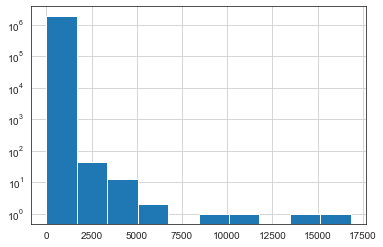

In [34]:
donations_13to17.count_total.hist(log=True)

In [41]:
fig=px.histogram(donations_13to17, x="count_total", log_y=True, nbins=20)
fig.show()

In [94]:
(donations_13to17.query('count_total > 1000').count()['id']/donations_13to17.count_total.count()).round(4)

0.0001

In [78]:
te=donations_13to17.query('count_total < 11')

In [79]:
ten.count_total.value_counts(normalize=True)*100

1     74.597534
2     13.741151
3      4.915999
4      2.459113
5      1.492780
6      0.954276
7      0.671013
8      0.495222
9      0.379549
10     0.293364
Name: count_total, dtype: float64

In [80]:
ten.count_total.value_counts(normalize=False)*100

1     137363600
2      25302900
3       9052300
4       4528200
5       2748800
6       1757200
7       1235600
8        911900
9        698900
10       540200
Name: count_total, dtype: int64

In [6]:
donations_13to17.count_total.describe()

count    1.876468e+06
mean     2.263755e+00
std      2.772833e+01
min      1.000000e+00
25%      1.000000e+00
50%      1.000000e+00
75%      2.000000e+00
max      1.683300e+04
Name: count_total, dtype: float64

In [48]:
# donors by # contributions
l = 12
for n in range(1,l+1,1):
    if n < l + 1:
        count=donations_13to17.loc[donations_13to17['count_total'] == n]
        print (count.count_total.count())
#         (n, f'/',
#               "{:,}".format(count.count_col.count()), f'/',
#               "{:.2%}".format(count.count_col.count()/count_df.count_col.count()), f'/',
#              "${:,.0f}".format(count.amount_col.sum()), f'/',
#              "{:.2%}".format(count.amount_col.sum()/count_df.amount_col.sum()))

1373636
253029
90523
45282
27488
17572
12356
9119
6989
5402
4279
3467


In [65]:
subset=donations_13to17.query('count_total > 0 & count_total < 49')

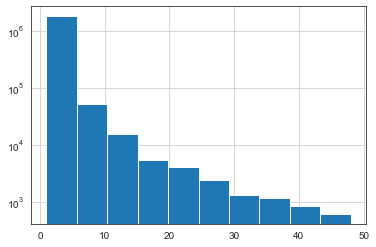

In [70]:
subset.count_total.hist(log=True)

In [72]:
subset.count_total.describe().round(2)

count    1872296.00
mean           1.83
std            2.78
min            1.00
25%            1.00
50%            1.00
75%            2.00
max           48.00
Name: count_total, dtype: float64

In [74]:
subset.count_total.value_counts(normalize=True)

1     0.733664
2     0.135144
3     0.048349
4     0.024185
5     0.014681
6     0.009385
7     0.006599
8     0.004870
9     0.003733
10    0.002885
11    0.002285
12    0.001852
13    0.001524
14    0.001310
15    0.001094
16    0.000869
17    0.000756
18    0.000685
19    0.000584
20    0.000524
21    0.000468
22    0.000443
23    0.000384
24    0.000355
25    0.000320
26    0.000277
27    0.000242
28    0.000231
29    0.000199
31    0.000191
30    0.000186
32    0.000164
33    0.000161
34    0.000152
37    0.000127
35    0.000126
36    0.000114
38    0.000106
39    0.000096
42    0.000091
40    0.000090
43    0.000089
41    0.000083
46    0.000071
48    0.000070
45    0.000068
44    0.000067
47    0.000050
Name: count_total, dtype: float64

In [63]:
1872296/1876468

0.997776674049331

In [95]:
yearly=donations_13to17.query('count_2013 < 2 & count_2014 < 2 & count_2015 < 2 & count_2016 < 2 & count_2017 < 2')

In [97]:
yearly.first_gift_year.value_counts()

2016-01-01    368953
2017-01-01    356464
2015-01-01    290390
2014-01-01    250941
2013-01-01    236201
Name: first_gift_year, dtype: int64

In [104]:
yearly.behavior_2017.value_counts()

none            715802
new             356464
lapse_new       342960
lapse_repeat     34963
recover          20518
downgrade        11284
maintain         11062
upgrade           9896
Name: behavior_2017, dtype: int64

In [108]:
yearly.behavior_2013.value_counts()

none    1266748
new      236201
Name: behavior_2013, dtype: int64

In [113]:
yearly.gift_pattern.value_counts(normalize=True)*100

5,            23.717638
4,            22.819138
3,            17.263194
2,            14.421381
1,            13.174699
4,5,           1.729467
3,4,           1.198178
2,3,           1.083204
1,2,           1.040887
3,5,           0.649656
2,4,           0.507935
1,3,           0.442397
2,5,           0.333677
1,4,           0.301075
3,4,5,         0.210320
1,5,           0.205263
1,2,3,         0.200739
2,3,4,         0.153432
2,3,5,         0.081107
2,4,5,         0.076982
1,2,4,         0.069064
1,3,4,         0.063409
1,4,5,         0.042982
1,2,5,         0.042250
2,3,4,5,       0.038857
1,3,5,         0.034466
1,2,3,4,       0.033201
1,2,3,5,       0.018763
1,2,3,4,5,     0.016767
1,3,4,5,       0.015636
1,2,4,5,       0.014239
Name: gift_pattern, dtype: float64

In [110]:
for col in yearly.columns:
    print(col)

id
first_gift_year
lapsed_count
recovered_count
max_consec_giving_years
total_giving_years
count_2013
count_2014
count_2015
count_2016
count_2017
count_yr0_x
count_yr1_x
count_yr2_x
count_yr3_x
count_yr4_x
lapsed_amount
recovered_amount
amount_2013
amount_2014
amount_2015
amount_2016
amount_2017
lapsed_amount_2013
lapsed_amount_2014
lapsed_amount_2015
lapsed_amount_2016
lapsed_amount_2017
upgraded_amount_2013
upgraded_amount_2014
upgraded_amount_2015
upgraded_amount_2016
upgraded_amount_2017
downgraded_amount_2013
downgraded_amount_2014
downgraded_amount_2015
downgraded_amount_2016
downgraded_amount_2017
amount_yr0
amount_yr1
amount_yr2
amount_yr3
amount_yr4
count_yr0_y
count_yr1_y
count_yr2_y
count_yr3_y
count_yr4_y
lapsed_amount_yr0
lapsed_amount_yr1
lapsed_amount_yr2
lapsed_amount_yr3
lapsed_amount_yr4
upgraded_amount_yr0
upgraded_amount_yr1
upgraded_amount_yr2
upgraded_amount_yr3
upgraded_amount_yr4
downgraded_amount_yr0
downgraded_amount_yr1
downgraded_amount_yr2
downgraded_amount